# ShorelineMonitor: Change Rate

The ShorelineMonitor dataset provides [Satellite-Derived Shorelines (SDS)](https://radiantearth.github.io/stac-browser/#/external/coclico.blob.core.windows.net/stac/v1/shorelinemonitor-shorelines/collection.json) extracted from annually
composited Landsat satellite imagery spanning the years 1984-2024. These shorelines offer a global
view of coastal change and shoreline dynamics, serving as a foundation for coastal
analytics, modeling and management. The shorelines have been mapped onto the [Global Coastal Transect System](https://radiantearth.github.io/stac-browser/#/external/coclico.blob.core.windows.net/stac/v1/gcts/collection.json) to form a [new dataset](https://radiantearth.github.io/stac-browser/#/external/coclico.blob.core.windows.net/stac/v1/shorelinemonitor-series/collection.json) of more than 7.5 million time-series. 

This notebook shows how to explore multi-decadal trends in shoreline change that are extracted from the full dataset of time series. The dataset is available upon reasonable request. Please contact the data provider for more information or collaboration opportunities.

In [31]:
import os

import numpy as np
import matplotlib.pyplot as plt
import dotenv
import fsspec
import geopandas as gpd
import hvplot.pandas
import pandas as pd
import pystac
import shapely
from dotenv import load_dotenv
from ipyleaflet import Map, basemaps
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from coastpy.stac.utils import read_snapshot

# Specify the absolute path to the .env file
dotenv_path = "/Users/juulhemmes/Documents/Studie/Msc/Thesis/coastpy/ATT64895.env"

load_dotenv(dotenv_path=dotenv_path)

# Configure cloud and Dask settings
sas_token = os.getenv("AZURE_STORAGE_SAS_TOKEN")
storage_options = {"account_name": "coclico", "sas_token": sas_token}

coclico_catalog = pystac.Catalog.from_file(
    "https://coclico.blob.core.windows.net/stac/v1/catalog.json"
)
collection = coclico_catalog.get_child("gctr")

In [32]:
snapshot = read_snapshot(collection, storage_options=storage_options)
snapshot.head()

,type,stac_version,stac_extensions,id,geometry,bbox,links,assets,collection,created,table:columns,proj:bbox,proj:epsg,table:row_count,datetime,href
0,Feature,1.0.0,[https://stac-extensions.github.io/table/v1.2....,n67e10-c90f1c,"POLYGON ((90.02796 66.50459, 90.02796 81.86757...","[10.415408379310252, 66.50458545284066, 90.027...",[{'href': 'https://coclico.blob.core.windows.n...,{'data': {'description': ' A Parquet dataset c...,gctr,2025-01-21 08:12:39.497699+00:00,[{'description': 'Unique identifier for each t...,"[10.415408379310252, 66.50458545284066, 90.027...",4326,523905,2023-02-09 00:00:00+00:00,az://gctr/release/2025-01-09/n67e10-c90f1c.par...
1,Feature,1.0.0,[https://stac-extensions.github.io/table/v1.2....,n67w180-e6c7b3,"POLYGON ((-89.95719 66.50558, -89.95719 81.939...","[-179.9997518656276, 66.50557986809558, -89.95...",[{'href': 'https://coclico.blob.core.windows.n...,{'data': {'description': ' A Parquet dataset c...,gctr,2025-01-21 08:12:39.497699+00:00,[{'description': 'Unique identifier for each t...,"[-179.9997518656276, 66.50557986809558, -89.95...",4326,650158,2023-02-09 00:00:00+00:00,az://gctr/release/2025-01-09/n67w180-e6c7b3.pa...
2,Feature,1.0.0,[https://stac-extensions.github.io/table/v1.2....,n67w90-d9edb1,"POLYGON ((-7.90362 66.50436, -7.90362 83.66967...","[-90.05929688568439, 66.50435737903862, -7.903...",[{'href': 'https://coclico.blob.core.windows.n...,{'data': {'description': ' A Parquet dataset c...,gctr,2025-01-21 08:12:39.497699+00:00,[{'description': 'Unique identifier for each t...,"[-90.05929688568439, 66.50435737903862, -7.903...",4326,803314,2023-02-09 00:00:00+00:00,az://gctr/release/2025-01-09/n67w90-d9edb1.par...
3,Feature,1.0.0,[https://stac-extensions.github.io/table/v1.2....,n69e90-175cd6,"POLYGON ((179.99986 68.75571, 179.99986 81.283...","[89.97127383184208, 68.75571417997578, 179.999...",[{'href': 'https://coclico.blob.core.windows.n...,{'data': {'description': ' A Parquet dataset c...,gctr,2025-01-21 08:12:39.497699+00:00,[{'description': 'Unique identifier for each t...,"[89.97127383184208, 68.75571417997578, 179.999...",4326,262137,2023-02-09 00:00:00+00:00,az://gctr/release/2025-01-09/n69e90-175cd6.par...
4,Feature,1.0.0,[https://stac-extensions.github.io/table/v1.2....,s00e90-3c5754,"POLYGON ((179.99973 -0.00884, 179.99973 65.083...","[89.99737841548624, -0.00884311529207947, 179....",[{'href': 'https://coclico.blob.core.windows.n...,{'data': {'description': ' A Parquet dataset c...,gctr,2025-01-21 08:12:39.497699+00:00,[{'description': 'Unique identifier for each t...,"[89.99737841548624, -0.00884311529207947, 179....",4326,1438133,2023-02-09 00:00:00+00:00,az://gctr/release/2025-01-09/s00e90-3c5754.par...


In [33]:
snapshot.explore()

In [34]:
from ipyleaflet import Map, basemaps

m = Map(basemap=basemaps.Esri.WorldImagery, scroll_wheel_zoom=True)
m.center = (43.32, -1.97)
m.zoom = 14
m.layout.height = "800px"
m

Map(center=[43.32, -1.97], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_o…

In [35]:
from coastpy.geo.utils import get_region_of_interest_from_map

# roi = get_region_of_interest_from_map(m, default_extent=(-30, 30, 50, 75))
# west, south, east, north = roi.geometry.item().bounds
west, south, east, north = -30, 30, 50, 75

## Fetch data from the database

In [36]:
import coastpy

db = coastpy.io.STACQueryEngine(
    stac_collection=collection,
    storage_backend="azure",
    columns = ["transect_id", "lon", "lat", "geometry", "continent", "common_country_name", "sds:change_rate"]  # when you don't need all data
)

In [37]:
from coastpy.utils.config import fetch_sas_token

sas_token = fetch_sas_token(sas_token)
df = db.get_data_within_bbox(west, south, east, north, sas_token=sas_token)
print(f"Shape: {df.shape}")
df.head()

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

Shape: (1685545, 7)


,transect_id,lon,lat,geometry,continent,common_country_name,sds:change_rate
0,cl40974s01tr01838470,15.168324,67.485245,"LINESTRING (15.15386 67.47819, 15.18279 67.4923)",EU,Norway,NaN
1,cl40974s01tr01839070,15.156324,67.488014,"LINESTRING (15.14579 67.48, 15.16686 67.49602)",EU,Norway,NaN
2,cl40974s01tr01839570,15.146755,67.490524,"LINESTRING (15.12775 67.48529, 15.16577 67.49576)",EU,Norway,NaN
3,cl40974s01tr01838670,15.164543,67.486298,"LINESTRING (15.15211 67.4787, 15.17698 67.4939)",EU,Norway,NaN
4,cl40974s01tr01838870,15.160488,67.487190,"LINESTRING (15.14963 67.47925, 15.17135 67.49514)",EU,Norway,NaN


In [1]:
print(df['continent'].unique())
df_europe = df[df['continent'] == 'EU']

NameError: name 'df' is not defined

In [39]:
ac = gpd.GeoDataFrame(
    df_europe[["transect_id", "sds:change_rate"]],
    geometry=gpd.GeoSeries.from_xy(df.lon, df.lat, crs=4326),
)

In [40]:
import hvplot.pandas  
import colorcet as cc

def plot_shoreline_change_trend(ac_gdf):
    """
    Simple hvplot visualization for shoreline change trends.
    """
    # Calculate the 2.5th and 97.5th percentiles to reduce extreme outliers
    lower_quantile = ac_gdf["sds:change_rate"].quantile(0.025)
    upper_quantile = ac_gdf["sds:change_rate"].quantile(0.975)

    # Define symmetric color limits around zero for clear erosion/accretion visualization
    max_abs_range = max(abs(lower_quantile), abs(upper_quantile))
    clim = (-max_abs_range, max_abs_range)
    
    plot = ac_gdf.hvplot(
        geo=True,
        tiles="EsriImagery",  
        color="sds:change_rate",
        cmap=cc.CET_D3[::-1],  
        clim=clim,
        frame_width=800,
        frame_height=600,
        colorbar=True,
        title="Shoreline Change Trend (m/year)",
        tools=["hover"],
    )
    
    return plot

In [41]:
plot_shoreline_change_trend(ac)

:Overlay
   .WMTS.I   :WMTS   [Longitude,Latitude]
   .Points.I :Points   [Longitude,Latitude]   (sds:change_rate)

In [42]:
# # Remove insignificant shoreline changes (-0.5 to 0.5 m/yr)
# df_europe = df_europe[(df_europe["sds:change_rate"] <= -0.5) | (df_europe["sds:change_rate"] >= 0.5)]
# ac = gpd.GeoDataFrame(
#     df_europe[["transect_id", "sds:change_rate"]],
#     geometry=gpd.GeoSeries.from_xy(df.lon, df.lat, crs=4326),
# )
# plot_shoreline_change_trend(ac)

In [43]:
from coastpy.utils.config import fetch_sas_token

sas_token = fetch_sas_token(sas_token)
df = db.get_data_within_bbox(west, south, east, north, sas_token=sas_token)
print(f"Shape: {df.shape}")
df.head()

df = df[df['continent'] == 'EU']    # Filter to Europe only

# Step 1: Sort dataset by transect ID to ensure consecutive order
df = df.sort_values(by=["transect_id"]).reset_index(drop=True)

# Step 2: Identify hotspots (50+ consecutive transects with the same trend exceeding ±0.5 m/y)
hotspot_lists = []  # Stores lists of consecutive transect IDs
current_hotspot = []  # Temporary storage for an ongoing hotspot group
current_trend = None  # Tracks whether we're in an erosion or accretion hotspot

for i in range(len(df)):
    transect_id = df.iloc[i]["transect_id"]
    change_rate = df.iloc[i]["sds:change_rate"]

    # Determine trend based on change rate
    if change_rate < -0.5:
        trend = "erosion"
    elif change_rate > 0.5:
        trend = "accretion"
    else:
        trend = None  # This is now allowed but won’t be considered a hotspot.

    if trend is None:  # If no strong trend, break the hotspot
        if len(current_hotspot) >= 51:  # Only keep valid hotspots
            hotspot_lists.append(current_hotspot)
        current_hotspot = []  # Reset for next potential hotspot
        current_trend = None
    elif current_trend is None:  # Start first hotspot
        current_hotspot.append(transect_id)
        current_trend = trend
    elif trend == current_trend:  # Continue hotspot if trend remains the same
        current_hotspot.append(transect_id)
    else:  # If trend switches, store the hotspot and start a new one
        if len(current_hotspot) >= 51:  # Only store valid hotspots
            hotspot_lists.append(current_hotspot)
        current_hotspot = [transect_id]  # Start a new hotspot
        current_trend = trend

# Append the last detected hotspot if it meets the threshold
if len(current_hotspot) >= 51:
    hotspot_lists.append(current_hotspot)

# # Step 3: Print hotspot lengths for investigation
# hotspot_lengths = [len(hotspot) for hotspot in hotspot_lists]
# print("Hotspot Length Counts:", hotspot_lengths)

# # Step 4: Count occurrences of different hotspot sizes
# hotspot_length_counts = Counter(hotspot_lengths)
# print("\nSummary of Hotspot Sizes:")
# for length, count in sorted(hotspot_length_counts.items()):
#     print(f"Hotspots of length {length}: {count}")

FloatProgress(value=0.0, layout=Layout(width='auto'), style=ProgressStyle(bar_color='black'))

Shape: (1685545, 7)


In [44]:
print(len(hotspot_lists))

209


In [45]:
from shapely.geometry import Polygon

# Identify hotspot statistics
hotspot_data = []

for hotspot in hotspot_lists:
    hotspot_df = df[df["transect_id"].isin(hotspot)]

    lat_center = hotspot_df["lat"].median()  # Central latitude
    lon_center = hotspot_df["lon"].median()  # Central longitude
    min_lat, max_lat = hotspot_df["lat"].min(), hotspot_df["lat"].max()
    min_lon, max_lon = hotspot_df["lon"].min(), hotspot_df["lon"].max()
    
    min_rate = hotspot_df["sds:change_rate"].min()  # Most severe erosion
    max_rate = hotspot_df["sds:change_rate"].max()  # Most extreme accretion
    mean_rate = hotspot_df["sds:change_rate"].mean()
    median_rate = hotspot_df["sds:change_rate"].median()

    # Compute hotspot length (100m per transect)
    hotspot_length_m = (len(hotspot) - 1) * 100  # Convert to meters
    hotspot_length_km = hotspot_length_m / 1000  # Convert to kilometers

    # Determine if it's an erosion or accretion hotspot
    trend_type = "erosion" if abs(min_rate) > max_rate else "accretion"
    max_abs_rate = max(abs(min_rate), abs(max_rate))  # Max absolute rate
    
    # Classify by rate bins
    if 0.5 <= max_abs_rate < 2:
        size_category = 50
    elif 2 <= max_abs_rate < 5:
        size_category = 100
    elif 5 <= max_abs_rate < 10:
        size_category = 200
    elif max_abs_rate >= 20:
        size_category = 400
    else:
        size_category = 10  # Default small size if unclear

    # Extract country name from dataset
    country_name = hotspot_df["common_country_name"].mode()[0]  # Most common country in the stretch

    # Create bounding box polygon from min/max lat/lon
    hotspot_polygon = Polygon([
        (min_lon, min_lat),  # Bottom-left
        (max_lon, min_lat),  # Bottom-right
        (max_lon, max_lat),  # Top-right
        (min_lon, max_lat),  # Top-left
        (min_lon, min_lat)   # Close the polygon
    ])

    # Store data for table
    hotspot_data.append({
        "lat": lat_center,
        "lon": lon_center,
        "min_lat": min_lat,
        "max_lat": max_lat,
        "min_lon": min_lon,
        "max_lon": max_lon,
        "trend": trend_type,
        "mean_rate": mean_rate,
        "min_rate": min_rate,
        "max_rate": max_rate,
        "median_rate": median_rate,
        "size_category": size_category,
        "hotspot_length_km": hotspot_length_km,
        "country": country_name,
        "geometry": hotspot_polygon  # Store polygon
    })

# Convert to GeoDataFrame
hotspot_gdf = gpd.GeoDataFrame(hotspot_data, geometry="geometry", crs="EPSG:4326")



In [46]:
hotspot_gdf = hotspot_gdf.sort_values(by=["hotspot_length_km"]).reset_index(drop=True)

In [47]:
hotspot_gdf


,lat,lon,min_lat,max_lat,min_lon,max_lon,trend,mean_rate,min_rate,max_rate,median_rate,size_category,hotspot_length_km,country,geometry
0,45.832596,30.162590,45.819729,45.846188,30.136211,30.188217,erosion,-0.952819,-1.269612,-0.534172,-0.967704,50,5.0,Ukraine,"POLYGON ((30.13621 45.81973, 30.18822 45.81973..."
1,46.267395,49.319569,46.255753,46.278561,49.291771,49.347305,accretion,5.562294,0.561177,26.450130,4.081998,400,5.0,Russia,"POLYGON ((49.29177 46.25575, 49.34731 46.25575..."
2,57.725388,22.438751,57.714962,57.735519,22.401583,22.476208,accretion,0.882757,0.535303,1.256450,0.902226,50,5.0,Latvia,"POLYGON ((22.40158 57.71496, 22.47621 57.71496..."
3,44.857342,29.613228,44.836708,44.879288,29.600725,29.619919,erosion,-9.713082,-17.095020,-1.568721,-9.583426,10,5.0,Romania,"POLYGON ((29.60073 44.83671, 29.61992 44.83671..."
4,64.969849,25.479046,64.950356,64.983543,25.445099,25.486382,accretion,1.166250,0.661427,1.821409,1.164798,50,5.0,Finland,"POLYGON ((25.4451 64.95036, 25.48638 64.95036,..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
204,44.524864,28.868586,44.468552,44.586441,28.812391,28.913015,erosion,-3.479399,-5.248867,-0.701231,-3.457621,200,15.4,Romania,"POLYGON ((28.81239 44.46855, 28.91302 44.46855..."
205,46.309406,49.224777,46.274342,46.339111,49.198284,49.282581,accretion,4.086340,0.670501,16.010626,3.446457,10,17.1,Russia,"POLYGON ((49.19828 46.27434, 49.28258 46.27434..."
206,66.405304,43.276726,66.334572,66.414452,43.086681,43.359287,erosion,-3.012032,-9.847405,-1.204288,-2.859111,200,17.6,Russia,"POLYGON ((43.08668 66.33457, 43.35929 66.33457..."
207,52.190575,4.377209,52.099529,52.292881,4.260530,4.467484,accretion,2.543606,0.548241,7.303989,2.317341,200,25.9,Netherlands,"POLYGON ((4.26053 52.09953, 4.46748 52.09953, ..."


In [48]:
# Find the longest hotspot
longest_hotspot = hotspot_gdf.loc[hotspot_gdf["hotspot_length_km"].idxmax()]
print(f"🔹 Longest Hotspot: {longest_hotspot['hotspot_length_km']:.2f} km")
print(f"   📍 Country: {longest_hotspot['country']}")
print(f"   🔴 Min Erosion Rate: {longest_hotspot['min_rate']:.2f} m/year")
print(f"   🟢 Max Accretion Rate: {longest_hotspot['max_rate']:.2f} m/year\n")

# Find the hotspot with the most severe erosion
highest_erosion_hotspot = hotspot_gdf.loc[hotspot_gdf["min_rate"].idxmin()]
print(f"⚠️ Most Severe Erosion: {highest_erosion_hotspot['min_rate']:.2f} m/year")
print(f"   📍 Country: {highest_erosion_hotspot['country']}")
print(f"   🌍 Location: ({highest_erosion_hotspot['lat']:.2f}, {highest_erosion_hotspot['lon']:.2f})\n")

# Find the hotspot with the highest accretion rate
highest_accretion_hotspot = hotspot_gdf.loc[hotspot_gdf["max_rate"].idxmax()]
print(f"✅ Highest Accretion: {highest_accretion_hotspot['max_rate']:.2f} m/year")
print(f"   📍 Country: {highest_accretion_hotspot['country']}")
print(f"   🌍 Location: ({highest_accretion_hotspot['lat']:.2f}, {highest_accretion_hotspot['lon']:.2f})\n")

# Country-level summary: Number of hotspots per country
country_counts = hotspot_gdf["country"].value_counts()
print("🌍 Number of Hotspots Per Country:")
print(country_counts.to_string(), "\n")

# Average hotspot length per country
country_avg_length = hotspot_gdf.groupby("country")["hotspot_length_km"].mean().sort_values(ascending=False)
print("📏 Average Hotspot Length Per Country (km):")
print(country_avg_length.to_string(), "\n")

# Country with the longest average hotspots
longest_avg_hotspot_country = country_avg_length.idxmax()
print(f"🏆 Country with Longest Average Hotspots: {longest_avg_hotspot_country} ({country_avg_length.max():.2f} km)\n")

# Mean and median erosion/accretion rates per country
country_stats = hotspot_gdf.groupby("country").agg(
    mean_erosion=("min_rate", "mean"),
    max_erosion=("min_rate", "min"),
    mean_accretion=("max_rate", "mean"),
    max_accretion=("max_rate", "max")
).sort_values(by="max_erosion", ascending=True)  # Sort by most severe erosion

print("📉 Most Severe Erosion & Accretion by Country:")
print(country_stats.to_string(), "\n")

# Most balanced country (where mean erosion and accretion are closest)
balanced_country = (country_stats["mean_erosion"] + country_stats["mean_accretion"]).abs().idxmin()
print(f"⚖️ Most Balanced Shoreline Change: {balanced_country} (Erosion: {country_stats.loc[balanced_country, 'mean_erosion']:.2f}, Accretion: {country_stats.loc[balanced_country, 'mean_accretion']:.2f})\n")

🔹 Longest Hotspot: 27.90 km
   📍 Country: Russia
   🔴 Min Erosion Rate: -3.07 m/year
   🟢 Max Accretion Rate: -0.55 m/year

⚠️ Most Severe Erosion: -76.85 m/year
   📍 Country: Netherlands
   🌍 Location: (53.44, 5.51)

✅ Highest Accretion: 74.53 m/year
   📍 Country: Romania
   🌍 Location: (44.77, 29.49)

🌍 Number of Hotspots Per Country:
country
Russia            48
Turkey            18
Ukraine           15
Italy             15
Romania           14
Germany           14
United Kingdom    14
Spain             11
Netherlands       11
France            10
Finland            8
Denmark            7
Portugal           6
Iceland            4
Albania            3
Belgium            2
Latvia             2
Estonia            2
Poland             2
Sweden             1
Ireland            1
Montenegro         1 

📏 Average Hotspot Length Per Country (km):
country
Netherlands       9.709091
Belgium           9.450000
Montenegro        8.500000
Russia            8.406250
Romania           8.378571
Den

In [49]:
# Compute total eroding and accreting coastline lengths per country
country_length_stats = hotspot_gdf.groupby(["country", "trend"])["hotspot_length_km"].sum().unstack(fill_value=0)

# Rename columns for clarity
country_length_stats.columns = ["Total Accreting Length (km)", "Total Eroding Length (km)"]

# Sort by longest eroding and accreting coastlines
longest_erosion_countries = country_length_stats.sort_values("Total Eroding Length (km)", ascending=False)
longest_accretion_countries = country_length_stats.sort_values("Total Accreting Length (km)", ascending=False)

# Print longest eroding coastlines
print("🌊 Countries with the Longest Total Eroding Coastlines (km):")
print(longest_erosion_countries["Total Eroding Length (km)"].to_string(), "\n")

# Print longest accreting coastlines
print("🏝️ Countries with the Longest Total Accreting Coastlines (km):")
print(longest_accretion_countries["Total Accreting Length (km)"].to_string(), "\n")

🌊 Countries with the Longest Total Eroding Coastlines (km):
country
Russia            204.6
Ukraine            79.1
United Kingdom     67.8
Romania            61.2
France             48.6
Denmark            34.7
Italy              33.7
Turkey             30.5
Spain              28.7
Germany            28.1
Portugal           18.8
Iceland            13.5
Netherlands        11.1
Albania             6.3
Poland              0.0
Belgium             0.0
Latvia              0.0
Ireland             0.0
Sweden              0.0
Finland             0.0
Estonia             0.0
Montenegro          0.0 

🏝️ Countries with the Longest Total Accreting Coastlines (km):
country
Russia            198.9
Turkey             97.8
Netherlands        95.7
Germany            75.2
Italy              67.8
Finland            57.9
Romania            56.1
Spain              48.2
United Kingdom     45.9
Portugal           25.7
Denmark            23.8
Ukraine            20.3
Belgium            18.9
France             

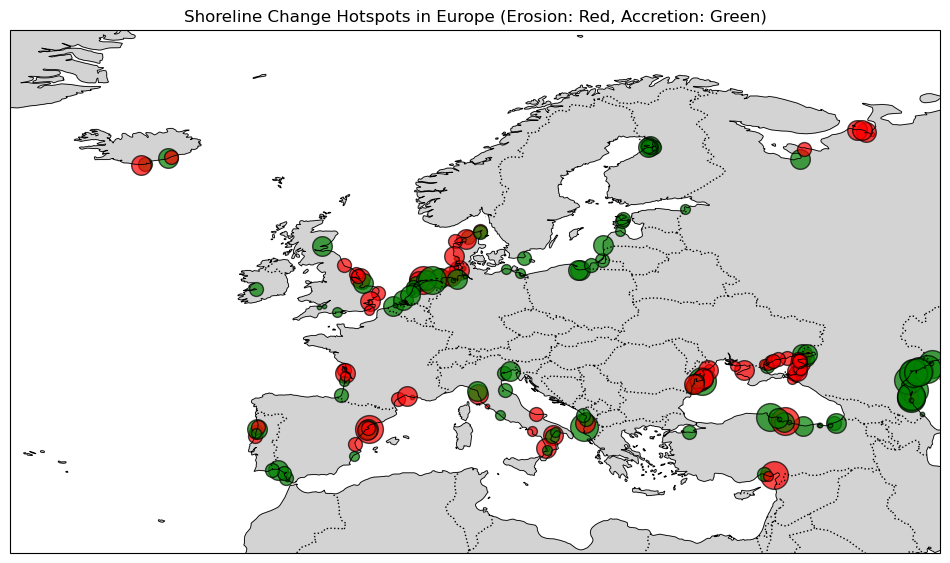

In [50]:
# Set up the figure and Cartopy projection
fig, ax = plt.subplots(figsize=(12, 8), subplot_kw={'projection': ccrs.PlateCarree()})

# Define the extent for Europe
ax.set_extent([-30, 50, 30, 75], crs=ccrs.PlateCarree())

# Add geographical features
ax.add_feature(cfeature.LAND, color="lightgray")
ax.add_feature(cfeature.BORDERS, linestyle=":")
ax.add_feature(cfeature.COASTLINE, linewidth=0.6)

# Plot each hotspot with corresponding color and size
for _, row in hotspot_gdf.iterrows():
    color = "red" if row["trend"] == "erosion" else "green"  # Red for erosion, green for accretion
    ax.scatter(row["lon"], row["lat"],
               s=row["size_category"], 
               color=color, alpha=0.7, edgecolors="k", transform=ccrs.PlateCarree())

# Add title and show plot
plt.title("Shoreline Change Hotspots in Europe (Erosion: Red, Accretion: Green)")
plt.show()


In [52]:
import pandas as pd
import ipywidgets as widgets
from ipyleaflet import Map, CircleMarker, LayerGroup, basemaps, basemap_to_tiles, WidgetControl
from IPython.display import display

# Define center of Europe for initial view
center = (50, 10)  # Approximate center of Europe
zoom = 4  # Zoom level to fit most of Europe

# Create interactive map
m = Map(basemap=basemap_to_tiles(basemaps.OpenStreetMap.Mapnik), center=center, zoom=zoom)

# Function to classify size based on erosion (min_rate) or accretion (max_rate)
def classify_size(trend, min_rate, max_rate):
    abs_rate = abs(min_rate) if trend == "erosion" else abs(max_rate)  # Correct scaling
    if 0.5 <= abs_rate < 2:
        return 5
    elif 2 <= abs_rate < 5:
        return 10
    elif 5 <= abs_rate < 10:
        return 15
    elif abs_rate >= 20:
        return 25
    return 3  # Default small size

# Create hotspot markers with correct size scaling and popups
hotspot_layers = []

for _, row in hotspot_gdf.iterrows():
    color = "red" if row["trend"] == "erosion" else "green"  # Red for erosion, green for accretion
    size = classify_size(row["trend"], row["min_rate"], row["max_rate"])  # Correct size logic
    
    # Create popup content
    popup_content = widgets.HTML(
        value=f"""
        <b>Hotspot Info</b><br>
        <b>Trend:</b> {row['trend'].capitalize()}<br>
        <b>Mean Rate:</b> {row['mean_rate']:.2f} m/yr<br>
        <b>Min Rate:</b> {row['min_rate']:.2f} m/yr<br>
        <b>Max Rate:</b> {row['max_rate']:.2f} m/yr<br>
        <b>Median Rate:</b> {row['median_rate']:.2f} m/yr
        """
    )

    marker = CircleMarker(
        location=(row["lat"], row["lon"]),
        radius=size,
        color=color,
        fill=True,
        fill_opacity=0.6,
        weight=1
    )
    marker.popup = popup_content  # Attach popup

    hotspot_layers.append(marker)

# Add all markers to a LayerGroup for efficient rendering
hotspot_layer_group = LayerGroup(layers=hotspot_layers)
m.add_layer(hotspot_layer_group)

# Create a legend widget for circle sizes
legend_html = """
<div style="position: fixed; bottom: 20px; left: 20px; background-color: white; padding: 10px; 
            border-radius: 5px; box-shadow: 0px 0px 5px rgba(0,0,0,0.2); font-size: 14px;">
    <b>Erosion/Accretion Rates</b><br>
    <span style="width: 10px; height: 10px; display: inline-block; background: gray; border-radius: 50%;"></span> 0.5 - 2 m/yr<br>
    <span style="width: 15px; height: 15px; display: inline-block; background: gray; border-radius: 50%;"></span> 2 - 5 m/yr<br>
    <span style="width: 20px; height: 20px; display: inline-block; background: gray; border-radius: 50%;"></span> 5 - 10 m/yr<br>
    <span style="width: 25px; height: 25px; display: inline-block; background: gray; border-radius: 50%;"></span> > 20 m/yr
</div>
"""

legend = widgets.HTML(value=legend_html)
legend_control = WidgetControl(widget=legend, position='bottomleft')
m.add_control(legend_control)

# Display the interactive map
m



Map(center=[50, 10], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [53]:
from ipyleaflet import WidgetControl
import ipywidgets as widgets

# Define the legend HTML with improved visibility
legend_html = """
<div style="
    position: relative;
    background-color: white;
    padding: 10px; 
    border-radius: 5px; 
    box-shadow: 2px 2px 5px rgba(0,0,0,0.3); 
    font-size: 14px;
    line-height: 1.6;
    width: 180px;
">
    <b>Erosion/Accretion Rates</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 0.5 - 2 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 16px; height: 16px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 2 - 5 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 20px; height: 20px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 5 - 10 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 25px; height: 25px; background: gray; border-radius: 50%; margin-right: 8px;"></div> > 20 m/yr
    </div>
</div>
"""

# Convert HTML to an ipywidgets HTML widget
legend_widget = widgets.HTML(value=legend_html)

# Ensure legend appears in bottom-left
legend_control = WidgetControl(widget=legend_widget, position='bottomleft')

# Add the legend control to the map
m.add_control(legend_control)

# Display the interactive map
m


Map(bottom=1671.0, center=[45.1510532655634, 19.072265625000004], controls=(ZoomControl(options=['position', '…

In [55]:
import folium

# Define center of Europe for initial view
map_center = [50, 10]  # Latitude, Longitude
m_folium = folium.Map(location=map_center, zoom_start=4, tiles="OpenStreetMap")

# Define function for correct sizing
def classify_size(trend, min_rate, max_rate):
    abs_rate = abs(min_rate) if trend == "erosion" else abs(max_rate)  # Correct scaling
    if 0.5 <= abs_rate < 2:
        return 5
    elif 2 <= abs_rate < 5:
        return 10
    elif 5 <= abs_rate < 10:
        return 15
    elif abs_rate >= 20:
        return 25
    return 3  # Default small size

# Add hotspots to the map
for _, row in hotspot_gdf.iterrows():
    color = "red" if row["trend"] == "erosion" else "green"  # Red for erosion, green for accretion
    size = classify_size(row["trend"], row["min_rate"], row["max_rate"])  # Correct size logic

    popup_content = f"""
    <b>Hotspot Info</b><br>
    <b>Trend:</b> {row['trend'].capitalize()}<br>
    <b>Mean Rate:</b> {row['mean_rate']:.2f} m/yr<br>
    <b>Min Rate:</b> {row['min_rate']:.2f} m/yr<br>
    <b>Max Rate:</b> {row['max_rate']:.2f} m/yr<br>
    <b>Median Rate:</b> {row['median_rate']:.2f} m/yr
    """

    folium.CircleMarker(
        location=[row["lat"], row["lon"]],
        radius=size,
        color=color,
        fill=True,
        fill_color=color,
        fill_opacity=0.6,
        popup=folium.Popup(popup_content, max_width=300)
    ).add_to(m_folium)

# Add a legend manually using HTML and CSS
legend_html = """
<div style="
    position: fixed; 
    bottom: 20px; left: 20px; 
    background-color: white; 
    padding: 10px; 
    border-radius: 5px; 
    box-shadow: 2px 2px 5px rgba(0,0,0,0.3); 
    font-size: 14px;
    line-height: 1.6;
    width: 180px;
    z-index:9999;
">
    <b>Erosion/Accretion Rates</b><br>
    <div style="display: flex; align-items: center;">
        <div style="width: 12px; height: 12px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 0.5 - 2 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 16px; height: 16px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 2 - 5 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 20px; height: 20px; background: gray; border-radius: 50%; margin-right: 8px;"></div> 5 - 10 m/yr
    </div>
    <div style="display: flex; align-items: center;">
        <div style="width: 25px; height: 25px; background: gray; border-radius: 50%; margin-right: 8px;"></div> > 20 m/yr
    </div>
</div>
"""

m_folium.get_root().html.add_child(folium.Element(legend_html))

# Save map as an interactive HTML file
map_filename = "shoreline_hotspots_map.html"
m_folium.save(map_filename)

print(f"✅ Map successfully saved as {map_filename}. Open this file in a browser to view it.")


✅ Map successfully saved as shoreline_hotspots_map.html. Open this file in a browser to view it.
